In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from utils.data import load_tc_data
from utils.plot import make_cmap



In [2]:
load_from_scratch=True
plt.rcParams.update({
    # Use LaTeX default serif font-family.
    # https://matplotlib.org/stable/tutorials/text/usetex.html#sphx-glr-tutorials-text-usetex-py
     "font.family": "sans-serif",
     # Use specific cursive fonts.
     "font.cursive": ["Comic Neue", "Comic Sans MS"],
 })
font = {'fontname':'Comic Neue'}

In [3]:
def calculate_composite_rainfall():
    return 'hi'
    

In [4]:
# print(inputs_x1)
# print(inputs)

In [5]:

# load current scalar wgan
real,inputs,pred,meta = load_tc_data(set='test',results='ke_tracks')
real_x,inputs_x1,pred_x1,meta_x1 = load_tc_data(set='extreme_test',results='ke_tracks')

# load modular gan
# modular_pred = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_pred-opt_modular_part2_raw.npy')
# modular_pred = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_test_pred-opt_scalar_test_run_1_pred-opt_modular_part2_raw.npy')
# modular_pred_x = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_extreme_test_pred-opt_scalar_test_run_1_pred-opt_modular_part2_raw.npy')
# modular_pred = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_test_pred-opt_scalar_test_run_1b_2_pred-opt_modular_part2_raw.npy')
# modular_pred_x = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_extreme_test_pred-opt_scalar_test_run_1b_2_pred-opt_modular_part2_raw.npy')
modular_pred = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_test_pred-opt_scalar_test_run_1_best_2_pred-opt_modular_part2_raw.npy')
modular_pred_x = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_extreme_test_pred-opt_scalar_test_run_1_best_2_pred-opt_modular_part2_raw.npy')
# modular_pred = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_test_pred-opt_scalar_test_run_5_pred-opt_modular_part2_raw.npy')
# modular_pred_x = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_extreme_test_pred-opt_scalar_test_run_5_pred-opt_modular_part2_raw.npy')
pred_mraw = np.load('/user/home/al18709/work/gan_predictions_20/test_pred-opt_modular_part2_raw.npy')
pred_mraw_x = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_pred-opt_modular_part2_raw.npy')
real = np.load('/user/home/al18709/work/gan_predictions_20/test_real-opt_modular_part2_raw.npy')
real_x = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_real-opt_modular_part2_raw.npy')

# load ibtracks
tracks = pd.read_csv('/user/home/al18709/work/ibtracks/tc_files.csv')
og_tracks_grouped = tracks.groupby('sid')

# load original 2D WGAN
# real_2,inputs_2,pred_2,meta_2,imput_og,pred_og,meta_og = load_tc_data(set='validation',results='kh_tracks')
real_og,_,_,_,_,_,pred_og,meta_og = load_tc_data(set='test',results='test')
real_og_x,_,_,_,_,_,pred_og_x,meta_og_x = load_tc_data(set='extreme_test',results='test')
meta_og = pd.read_csv('/user/work/al18709/tc_data_mswep_40/test_meta.csv')
# meta_valid = pd.read_csv('/user/work/al18709/tc_data_flipped/valid_meta.csv')
meta = pd.read_csv('/user/work/al18709/tc_data_flipped/test_meta.csv')
meta_x1 = pd.read_csv('/user/work/al18709/tc_data_flipped/extreme_test_meta.csv')



In [6]:


def calc_nyears(meta):
	nyears = int(meta.year[len(meta.year)-1] - meta.year[0] + 1)
	return nyears




In [7]:
# load dataset
# load data
def generate_composite_rainfall(meta,rain,ibtracks=False,time_sample_rate=False,rain_rate=False,imerg=False,mmday=False):
	
	

	# get subset of storms
	sids = meta.sid
	# if hist == True:
	# 	bool = [yr in range(2069,2100) for yr in meta.year]
	# 	print(bool)
	# 	sids = meta.loc[bool, 'sid']
	# 	print(sids)
	sids_unique=sids.drop_duplicates()
	nstorms = len(sids_unique)
	# avg_timesteps = len(sids)/nstorms
	tracks_grouped = meta.groupby('sid')
	composite_storm_rain = np.zeros((nstorms,100,100))
	i=0
	drop_idx=[]
	south_idx=[]
	north_idx=[]
	# find time frequency
	for sid in sids_unique:
		storm = tracks_grouped.get_group(sid)
		if ibtracks != False:
			storm_full = ibtracks.get_group(sid)
		else:
			storm_full = storm

		if time_sample_rate==False:
			
			hourly_rate=[]
			print(storm_full)
			for h in storm_full.hour:
				if h in [3,9,15,21]:
					hour_rate = 3
				elif h in [0,6,12,18]:
					hour_rate = 6
				else:
					hour_rate = 0
				
				hourly_rate.append(hour_rate)

			# calculate hourly rates
			if set(hourly_rate) == {3,6}:
				# calculate storm duration as time rate (3 or 6 hourly time points) * number of time points
				storm_duration = 3 * len(storm) # this gives how many hours storm was alive for as a TC
				# define unit converstion as rain/storm_duration (number of hours) * 24 to get daily rain rate
				units_converter = 24/storm_duration

			elif 6 in set(hourly_rate): # so this means one datapoint every 6 hours
				storm_duration = 6 * len(storm) # this gives how many hours storm was alive for as a TC
				# need to multiply the rain by 2 because units are mm/3h, right now only accounting for half the rain, so multiplying by 2 is interpolating for rain between values
				units_converter = 24 * 2/storm_duration
				
			else:
				print('storm set is strange')
				print(set(hourly_rate))
				units_converter = 0
		else:
			
			storm_duration = time_sample_rate * len(storm)
			# if rain_rate == False: # if rain is sampled at same time as track
			units_converter = 24 / storm_duration
			# else: # otherwise rain is counted 3 hourly so needs to be doubled as tracks are counted 6 hourly so we're missing out on half the rain
			# 	units_converter = 24*rain_rate / storm_duration
			# TODO: maybe this needs to be average rain per day not total rain added up then divided by number of days.
			# so instead of 24/storm_duration which would be smaller for longer storms?
			# it would be or maybe it's correct
			# 
		# # rain_rate is applied if storms are 3 hourly not 6 hourly, so rain rate is doubled becuase we are only counting 6 hourly
		# but then rain is mm/hr so actually we add up over the 6 hour track time so don't need to worry about this.
		# if rain_rate != False:
		# 	unites_converter = rain_rate * unites_converter
		if imerg == True:
			units_converter = 3 * units_converter
		storm_lats = storm.centre_lat
		storm_lons = storm.centre_lon
		# print(storm.index)
		storm_rain = rain[storm.index,:,:,0]
		# remove negative rain?
		storm_rain[storm_rain < 0] = 0
		
		# rain_data = rain_data * 86400/4 don't forget original cmip6 data was in precip flux units, so I converted to mm/6hr
		mean_storm_rain = np.sum(storm_rain,axis=0)*units_converter
		# storm_month = storm.month
		# storm_year = storm.year
		# storm_v = storm.v
		if units_converter == 0:
			drop_idx.append(i)
		else:
			if np.sum(storm_lats) < 0:
				south_idx.append(i)
			else:
				north_idx.append(i)
		

		composite_storm_rain[i,:,:] = mean_storm_rain
		i=i+1

	# save plottable dataset
	# composite_rainfall = calculate_composite_rainfall()
	# delete timestamps we can't use
	# np.delete(composite_storm_rain,drop_idx,axis=0)
	# get nh and sh datasets
	composite_storm_rain_nh = composite_storm_rain[north_idx,:,:]
	composite_storm_rain_sh = composite_storm_rain[south_idx,:,:]
	# print(composite_storm_rain.shape)
	# print(composite_storm_rain_nh.shape)
	# print(composite_storm_rain_sh.shape)
	composite_nh = np.mean(composite_storm_rain_nh,axis=0)
	composite_sh = np.mean(composite_storm_rain_sh,axis=0)

	if mmday ==True:
		return composite_storm_rain_nh,composite_storm_rain_sh
	else:
		return composite_nh,composite_sh,len(north_idx),len(south_idx)




In [8]:
real_sum_nh,real_sum_sh = generate_composite_rainfall(meta,real,ibtracks=og_tracks_grouped,mmday=True)
real_sum_nh_x,real_sum_sh_x = generate_composite_rainfall(meta_og_x,real_x,ibtracks=og_tracks_grouped,mmday=True)
real_sum_nh = np.mean(real_sum_nh,axis=(1,2)) 
real_sum_sh = np.mean(real_sum_sh,axis=(1,2)) 
real_sum_nh_x = np.mean(real_sum_nh_x,axis=(1,2)) 
real_sum_sh_x = np.mean(real_sum_sh_x,axis=(1,2)) 

swgan_sum_nh,swgan_sum_sh = generate_composite_rainfall(meta,pred,ibtracks=og_tracks_grouped,mmday=True)
swgan_sum_nh_x,swgan_sum_sh_x = generate_composite_rainfall(meta_x1,pred_x1,ibtracks=og_tracks_grouped,mmday=True)
swgan_sum_nh = np.mean(swgan_sum_nh,axis=(1,2)) 
swgan_sum_sh = np.mean(swgan_sum_sh,axis=(1,2)) 
swgan_sum_nh_x = np.mean(swgan_sum_nh_x,axis=(1,2)) 
swgan_sum_sh_x = np.mean(swgan_sum_sh_x,axis=(1,2))

mwgan_sum_nh,mwgan_sum_sh = generate_composite_rainfall(meta,modular_pred,ibtracks=og_tracks_grouped,mmday=True)
mwgan_sum_nh_x,mwgan_sum_sh_x = generate_composite_rainfall(meta_x1,modular_pred_x,ibtracks=og_tracks_grouped,mmday=True)
mwgan_sum_nh = np.mean(mwgan_sum_nh,axis=(1,2))
mwgan_sum_sh = np.mean(mwgan_sum_sh,axis=(1,2))
mwgan_sum_nh_x = np.mean(mwgan_sum_nh_x,axis=(1,2))
mwgan_sum_sh_x = np.mean(mwgan_sum_sh_x,axis=(1,2))

print(real_sum_nh.shape)


     Unnamed: 0                                     filepath_imerg  \
422         422  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
423         423  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
424         424  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
425         425  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
426         426  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
427         427  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
428         428  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
429         429  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
430         430  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
431         431  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
432         432  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
433         433  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
434         434  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
435         435  /bp

      Unnamed: 0                                     filepath_imerg  \
6888        6888  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6889        6889  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6890        6890  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6891        6891  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6892        6892  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6893        6893  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6894        6894  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6895        6895  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6896        6896  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6897        6897  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6898        6898  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6899        6899  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6900        6900  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
6901  

In [9]:
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
from scipy.stats import pearsonr
import matplotlib.lines as mlines

swgan_nh correlation coefficient:  0.7116808941286255 p-value: 8.019732770652722e-37
mwgan_nh correlation coefficient:  0.7891765944146664 p-value: 3.576001695996922e-50
swgan_sh correlation coefficient:  0.6624344340025258 p-value: 1.8813952973740287e-14
mwgan_sh correlation coefficient:  0.6471558502217183 p-value: 1.1485449473495633e-13
swgan_nh_x correlation coefficient:  0.6246435418392433 p-value: 2.776974624202912e-10
mwgan_nh_x correlation coefficient:  0.7982759746320517 p-value: 1.605607188140941e-19
swgan_sh_x correlation coefficient:  0.009780043451854382 p-value: 0.971324362347378
mwgan_sh_x correlation coefficient:  0.500888497410929 p-value: 0.04811818987874701
[]
[]
[<matplotlib.lines.Line2D object at 0x7fe7dd1329d0>, <matplotlib.lines.Line2D object at 0x7fe7dd132710>, <matplotlib.lines.Line2D object at 0x7fe7dd10d7d0>, <matplotlib.lines.Line2D object at 0x7fe7db745bd0>, <matplotlib.lines.Line2D object at 0x7fe7db7461d0>]


/tmp/ipykernel_71875/3113014911.py:81: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axes[0].legend(['Perfect prediction','Model prediction distribution'],handles=handles,fontsize=12)
/tmp/ipykernel_71875/3113014911.py:97: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  axes[1].legend(['Perfect prediction','Model prediction distribution'],handles=handles,fontsize=12)


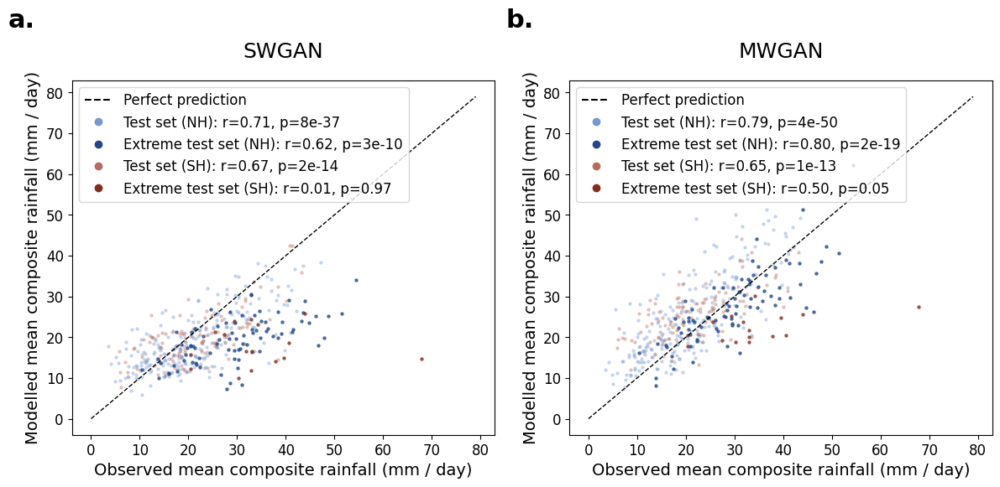

In [10]:
fig,axes = plt.subplots(1,2,figsize=(12,6))
# axes[0].plot(range(120000),range(120000),linestyle='--',linewidth=1,color='Black')
# axes[1].plot(range(120000),range(120000),linestyle='--',linewidth=1,color='Black')

axes[0].plot(range(80),range(80),linestyle='--',linewidth=1,color='Black')
axes[1].plot(range(80),range(80),linestyle='--',linewidth=1,color='Black')

# axes[0,2].plot(real_sum,real_sum,linestyle='--',color='Red')

# axes[1,2].spines[['right', 'top','left','bottom']].set_visible(False)
# axes[1,2].set_visible(False)
# ax.scatter(real_sum,swgan_sum,alpha=0.5)
# ax.scatter(real_sum,mwgan_sum,alpha=0.5)
# ax.scatter(real_sum,pred_og_sum,alpha=0.5)
# ax.scatter(real_sum,mwgan_p2_sum,alpha=0.5)
# ax.scatter(real_sum,patchloss_sum,alpha=0.5)
for ax in axes.flat:
    # ax.set(xlabel='Observed total rainfall (mm)', ylabel=Predicted total rainfall (mm)')
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel(xlabel='Observed mean composite rainfall (mm / day)')
    ax.set_ylabel(ylabel='Modelled mean composite rainfall (mm / day)')
    ax.xaxis.label.set_size(14)
    ax.yaxis.label.set_size(14)


# sns.kdeplot(x=real_sum_nh,y=swgan_sum_nh, shade=True, shade_lowest=False, alpha=0.7, cbar=False, ax=axes[0], cmap="Blues")
# sns.kdeplot(x=real_sum_nh,y=mwgan_sum_nh, shade=True, shade_lowest=False, alpha=0.7, cbar=False, ax=axes[1], cmap="Blues")

axes[0].scatter(x=real_sum_nh,y=swgan_sum_nh,s=5,alpha=0.3,color='#7598d1')
correlation_coefficient, p_value = pearsonr(x=real_sum_nh,y=swgan_sum_nh)
print('swgan_nh correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[1].scatter(x=real_sum_nh,y=mwgan_sum_nh,s=5,alpha=0.3,color='#7598d1')
correlation_coefficient, p_value = pearsonr(x=real_sum_nh,y=mwgan_sum_nh)
print('mwgan_nh correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[0].scatter(x=real_sum_sh,y=swgan_sum_sh,s=5,alpha=0.3,color='#ba6b5b')
correlation_coefficient, p_value = pearsonr(x=real_sum_sh,y=swgan_sum_sh)
print('swgan_sh correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[1].scatter(x=real_sum_sh,y=mwgan_sum_sh,s=5,alpha=0.3,color='#ba6b5b')
correlation_coefficient, p_value = pearsonr(x=real_sum_sh,y=mwgan_sum_sh)
print('mwgan_sh correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[0].scatter(x=real_sum_nh_x,y=swgan_sum_nh_x,s=5,alpha=0.7,color='#20488a')
correlation_coefficient, p_value = pearsonr(x=real_sum_nh_x,y=swgan_sum_nh_x)
print('swgan_nh_x correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[1].scatter(x=real_sum_nh_x,y=mwgan_sum_nh_x,s=5,alpha=0.7,color='#20488a')
correlation_coefficient, p_value = pearsonr(x=real_sum_nh_x,y=mwgan_sum_nh_x)
print('mwgan_nh_x correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[0].scatter(x=real_sum_sh_x,y=swgan_sum_sh_x,s=5,alpha=0.7,color='#852d1c')
correlation_coefficient, p_value = pearsonr(x=real_sum_sh_x,y=swgan_sum_sh_x)
print('swgan_sh_x correlation coefficient: ',correlation_coefficient,'p-value:', p_value)

axes[1].scatter(x=real_sum_sh_x,y=mwgan_sum_sh_x,s=5,alpha=0.7,color='#852d1c')
correlation_coefficient, p_value = pearsonr(x=real_sum_sh_x,y=mwgan_sum_sh_x)
print('mwgan_sh_x correlation coefficient: ',correlation_coefficient,'p-value:', p_value)
# sns.kdeplot(x=real_og_sum,y=pred_og_sum, shade=True, shade_lowest=False, alpha=0.7, cbar=False, ax=axes[0,2], cmap="Reds")

# ax.scatter(x=real_sum,y=swgan_sum, color="C0")
# ax.scatter(x=real_sum,y=mwgan_sum, color="C1")

# axes[0,2].set_title('WGAN (Vosper et al., 2023)',fontsize=18,pad=padding)
padding =20
axes[1].set_title('MWGAN',fontsize=18,pad=padding)
axes[0].set_title('SWGAN',fontsize=18,pad=padding)
line = Line2D([0], [0], label='Perfect prediction', color='Black',linestyle='dashed')
blue_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#7598d1',markeredgecolor='#7598d1',color='none', label='Test set (NH): r=0.71, p=8e-37')
blue_x_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#20488a',markeredgecolor='#20488a',color='none', label='Extreme test set (NH): r=0.62, p=3e-10')
red_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#ba6b5b', markeredgecolor='#ba6b5b',color='none', label='Test set (SH): r=0.67, p=2e-14')
red_x_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#852d1c',markeredgecolor='#852d1c',color='none', label='Extreme test set (SH): r=0.01, p=0.97')
handles, labels = axes[0].get_legend_handles_labels()
print(handles)
handles.append(line)
handles.append(blue_patch) 
handles.append(blue_x_patch) 
handles.append(red_patch) 
handles.append(red_x_patch) 
axes[0].legend(['Perfect prediction','Model prediction distribution'],handles=handles,fontsize=12)

line = Line2D([0], [0], label='Perfect prediction', color='Black',linestyle='dashed')
blue_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#7598d1',markeredgecolor='#7598d1',color='none', label='Test set (NH): r=0.79, p=4e-50')
blue_x_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#20488a',markeredgecolor='#20488a',color='none', label='Extreme test set (NH): r=0.80, p=2e-19')
red_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#ba6b5b', markeredgecolor='#ba6b5b',color='none',label='Test set (SH): r=0.65, p=1e-13')
red_x_patch = mlines.Line2D([], [], marker='o',markerfacecolor='#852d1c',markeredgecolor='#852d1c',color='none', label='Extreme test set (SH): r=0.50, p=0.05')
handles, labels = axes[1].get_legend_handles_labels()
print(handles)
handles.append(line)
handles.append(blue_patch) 
handles.append(blue_x_patch) 
handles.append(red_patch) 
handles.append(red_x_patch) 

print(handles)
axes[1].legend(['Perfect prediction','Model prediction distribution'],handles=handles,fontsize=12)

axes[0].text(-0.15, 1.15, 'a.', transform=axes[0].transAxes, size=22, weight='bold')
axes[1].text(-0.15, 1.15, 'b.', transform=axes[1].transAxes, size=22, weight='bold')

fig.subplots_adjust(left=0.3, right=0.9, top=0.9, bottom=0.1)
# axes[0,5].set_title('Truth',fontsize=18,pad=padding)
plt.tight_layout()
plt.savefig('total_rainfall_not_conserved_chapter2_b.png',bbox_inches='tight')


In [11]:
# Obs and WGAN
# composite_nh,composite_sh,nstorms_nh,nstorms_sh = generate_composite_rainfall(meta,real,ibtracks=og_tracks_grouped)
# composite_nh_x,composite_sh_x,nstorms_x_nh,nstorms_x_sh = generate_composite_rainfall(meta_og_x,np.expand_dims(real_og_x,axis=-1),ibtracks=og_tracks_grouped)
composite_nh,composite_sh,nstorms_nh,nstorms_sh = generate_composite_rainfall(meta,real,ibtracks=og_tracks_grouped)
composite_nh_x,composite_sh_x,nstorms_x_nh,nstorms_x_sh = generate_composite_rainfall(meta_og_x,real_x,ibtracks=og_tracks_grouped)

composite_og_nh,composite_og_sh,nstorms_og_nh,nstorms_og_sh = generate_composite_rainfall(meta_og,pred_og,ibtracks=og_tracks_grouped)
composite_og_x_nh,composite_og_x_sh,nstorms_og_x_sh,nstorms_og_x_sh = generate_composite_rainfall(meta_og_x,pred_og_x,ibtracks=og_tracks_grouped)

composite_mraw_nh,composite_mraw_sh,nstorms_mraw_nh,nstorms_mraw_sh = generate_composite_rainfall(meta,pred_mraw,ibtracks=og_tracks_grouped)
composite_mraw_x_nh,composite_mraw_x_sh,nstorms_mraw_x_nh,nstorms_mraw_x_sh = generate_composite_rainfall(meta_x1,pred_mraw_x,ibtracks=og_tracks_grouped)

composite_wgan_nh,composite_wgan_sh,nstorms_wgan_nh,nstorms_wgan_sh = generate_composite_rainfall(meta,pred,ibtracks=og_tracks_grouped)
composite_wgan_nh_x1,composite_wgan_sh_x1,nstorms_wgan_nh_x1,nstorms_wgan_sh_x1 = generate_composite_rainfall(meta_x1,pred_x1,ibtracks=og_tracks_grouped)

composite_modular_nh,composite_modular_sh,nstorms_modular_nh,nstorms_modular_sh = generate_composite_rainfall(meta,modular_pred,ibtracks=og_tracks_grouped)
composite_modular_wgan_nh_x1,composite_modular_wgan_sh_x1,nstorms_modular_wgan_nh_x1,nstorms_modular_wgan_sh_x1 = generate_composite_rainfall(meta_x1,modular_pred_x,ibtracks=og_tracks_grouped)




# imerg
# set imerg=True?
# i don't think we need to multiply rain by 3 hours maybe? because its rain rate over the hour so we assume it rains at the same rate for 3 or 6 hours depending on the track?
# I think the storm track is handling the fact its rain rate and not accumulated rainfall here.


     Unnamed: 0                                     filepath_imerg  \
422         422  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
423         423  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
424         424  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
425         425  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
426         426  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
427         427  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
428         428  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
429         429  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
430         430  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
431         431  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
432         432  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
433         433  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
434         434  /bp1/geog-tropical/data/Obs/IMERG/half_hourly/...   
435         435  /bp

In [12]:
# define cmap
precip_cmap,precip_norm = make_cmap()

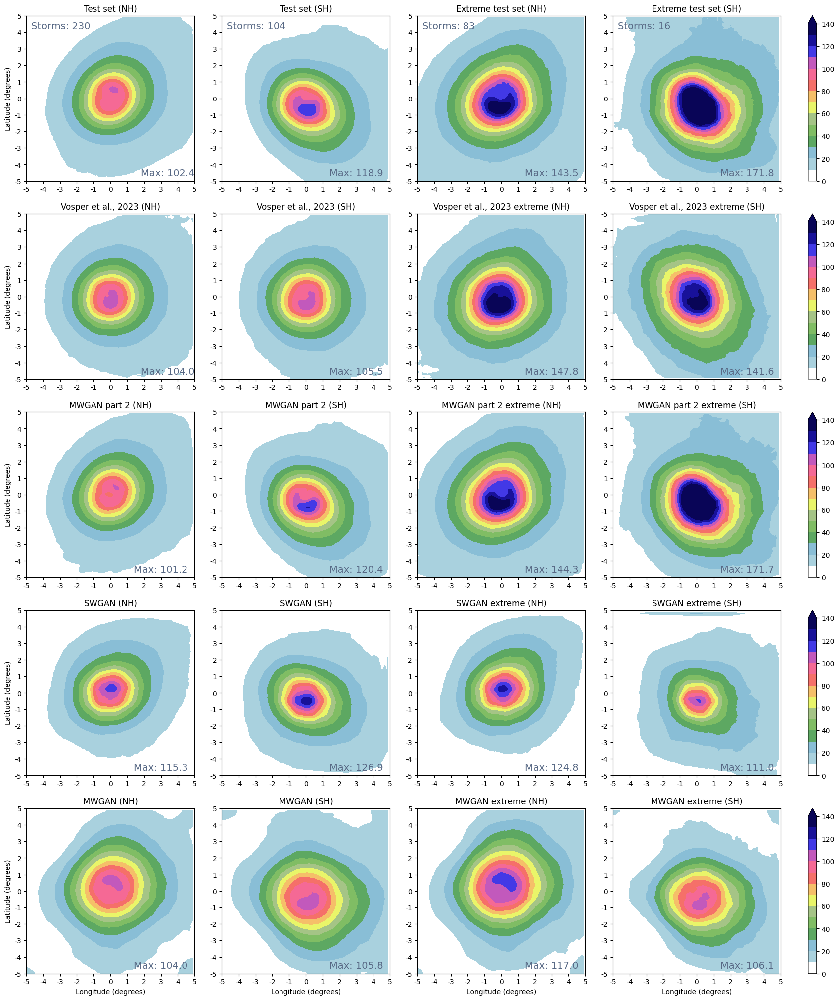

In [13]:

fig,axes = plt.subplots(5,5,figsize=(20.5, 25),gridspec_kw={'width_ratios': [1, 1, 1, 1, 0.05]})
levels = [0,10,20,30,40,50,60,70,80,90,100,110,120,130,140]
# levels = [0,10,20,30,40,50,60,70,80,90,100,110,120,130,140,160,180,200,220,240]

# MSWEP Obs
im = axes[0,0].contourf(composite_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[0,0].annotate('Max: %.1f' % np.max(composite_nh), xy = (90,90), xytext=(68,3),fontsize=14, color='#586985')
axes[0,0].annotate('Storms: %.0f' % nstorms_nh, xy = (90,90), xytext=(3,92),fontsize=14, color='#586985')
# axes[0,0].annotate('Storms per year: %.0f' % (int(nstorms_nh) / nyea), xy = (90,90), xytext=(3,92),fontsize=14, color='#586985')
axes[0,1].contourf(composite_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[0,1].annotate('Max: %.1f' % np.max(composite_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
axes[0,1].annotate('Storms: %.0f' % nstorms_sh, xy = (90,90), xytext=(3,92),fontsize=14, color='#586985')
axes[0,2].contourf(composite_nh_x,cmap=precip_cmap,levels=levels,extend='max')
axes[0,2].annotate('Max: %.1f' % np.max(composite_nh_x), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
axes[0,2].annotate('Storms: %.0f' % nstorms_x_nh, xy = (90,90), xytext=(3,92),fontsize=14, color='#586985')
axes[0,3].contourf(composite_sh_x,cmap=precip_cmap,levels=levels,extend='max')
axes[0,3].invert_yaxis()
axes[0,3].annotate('Max: %.1f' % np.max(composite_sh_x), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
axes[0,3].annotate('Storms: %.0f' % nstorms_x_sh, xy = (90,90), xytext=(3,92),fontsize=14, color='#586985')
axes[0,3].invert_yaxis()

# OG WGAN
axes[1,0].contourf(composite_og_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[1,0].annotate('Max: %.1f' % np.max(composite_og_nh), xy = (90,90), xytext=(68,3),fontsize=14, color='#586985')
im_og_sh = axes[1,1].contourf(composite_og_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[1,1].annotate('Max: %.1f' % np.max(composite_og_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_og_x_nh = axes[1,2].contourf(composite_og_x_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[1,2].annotate('Max: %.1f' % np.max(composite_og_x_nh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
axes[1,3].invert_yaxis()
im_og_x_sh = axes[1,3].contourf(composite_og_x_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[1,3].annotate('Max: %.1f' % np.max(composite_og_x_sh), xy = (90,90), xytext=(64,97),fontsize=14, color='#586985')

# mraw WGAN
axes[2,0].contourf(composite_mraw_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[2,0].annotate('Max: %.1f' % np.max(composite_mraw_nh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[2,1].contourf(composite_mraw_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[2,1].annotate('Max: %.1f' % np.max(composite_mraw_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')

axes[2,2].contourf(composite_mraw_x_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[2,2].annotate('Max: %.1f' % np.max(composite_mraw_x_nh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[2,3].contourf(composite_mraw_x_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[2,3].annotate('Max: %.1f' % np.max(composite_mraw_x_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')



# Scalar WGAN
axes[3,0].contourf(composite_wgan_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[3,0].annotate('Max: %.1f' % np.max(composite_wgan_nh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[3,1].contourf(composite_wgan_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[3,1].annotate('Max: %.1f' % np.max(composite_wgan_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')

axes[3,2].contourf(composite_wgan_nh_x1,cmap=precip_cmap,levels=levels,extend='max')
axes[3,2].annotate('Max: %.1f' % np.max(composite_wgan_nh_x1), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[3,3].contourf(composite_wgan_sh_x1,cmap=precip_cmap,levels=levels,extend='max')
axes[3,3].annotate('Max: %.1f' % np.max(composite_wgan_sh_x1), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')

# modular WGAN
axes[4,0].contourf(composite_modular_nh,cmap=precip_cmap,levels=levels,extend='max')
axes[4,0].annotate('Max: %.1f' % np.max(composite_modular_nh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[4,1].contourf(composite_modular_sh,cmap=precip_cmap,levels=levels,extend='max')
axes[4,1].annotate('Max: %.1f' % np.max(composite_modular_sh), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')

axes[4,2].contourf(composite_modular_wgan_nh_x1,cmap=precip_cmap,levels=levels,extend='max')
axes[4,2].annotate('Max: %.1f' % np.max(composite_modular_wgan_nh_x1), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')
im_pred_sh = axes[4,3].contourf(composite_modular_wgan_sh_x1,cmap=precip_cmap,levels=levels,extend='max')
axes[4,3].annotate('Max: %.1f' % np.max(composite_modular_wgan_sh_x1), xy = (90,90), xytext=(64,3),fontsize=14, color='#586985')




# Set the tick positions
t_p = [0,10,20,30,40,50,60,70,80,90,100]
t_l = [-5,-4,-3,-2,-1,0,1,2,3,4,5]
for i in range(5):
	for j in range(4):
		axes[i,j].set_xticks(t_p)
		axes[i,j].set_yticks(t_p)
		# Set the tick labels
		axes[i,j].set_xticklabels(t_l)
		axes[i,j].set_yticklabels(t_l)


axes[0,0].set_title('Test set (NH)')

axes[0,1].set_title('Test set (SH)')
axes[0,2].set_title('Extreme test set (NH)')
axes[0,3].set_title('Extreme test set (SH)')

axes[1,0].set_title('Vosper et al., 2023 (NH)')
axes[1,1].set_title('Vosper et al., 2023 (SH)')
axes[1,2].set_title('Vosper et al., 2023 extreme (NH)')
axes[1,3].set_title('Vosper et al., 2023 extreme (SH)')

axes[2,0].set_title('MWGAN part 2 (NH)')
axes[2,1].set_title('MWGAN part 2 (SH)')
axes[2,2].set_title('MWGAN part 2 extreme (NH)')
axes[2,3].set_title('MWGAN part 2 extreme (SH)')

axes[3,0].set_title('SWGAN (NH)')
axes[3,1].set_title('SWGAN (SH)')
axes[3,2].set_title('SWGAN extreme (NH)')
axes[3,3].set_title('SWGAN extreme (SH)')

axes[4,0].set_title('MWGAN (NH)')
axes[4,1].set_title('MWGAN (SH)')
axes[4,2].set_title('MWGAN extreme (NH)')
axes[4,3].set_title('MWGAN extreme (SH)')



axes[4,0].set_xlabel('Longitude (degrees)')
axes[4,1].set_xlabel('Longitude (degrees)')
axes[4,2].set_xlabel('Longitude (degrees)')
axes[4,3].set_xlabel('Longitude (degrees)')
axes[0,0].set_ylabel('Latitude (degrees)')
axes[1,0].set_ylabel('Latitude (degrees)')
axes[2,0].set_ylabel('Latitude (degrees)')
axes[3,0].set_ylabel('Latitude (degrees)')
axes[4,0].set_ylabel('Latitude (degrees)')

plt.colorbar(im,ticks=[0,20,40,60,80,100,120,140],cax=axes[0,4])
plt.colorbar(im,ticks=[0,20,40,60,80,100,120,140],cax=axes[1,4])
plt.colorbar(im,ticks=[0,20,40,60,80,100,120,140],cax=axes[2,4])
plt.colorbar(im,ticks=[0,20,40,60,80,100,120,140],cax=axes[3,4])
plt.colorbar(im,ticks=[0,20,40,60,80,100,120,140],cax=axes[4,4])



plt.savefig('composite_rain_gan11.png',bbox_inches='tight')
# reason why NH looks wrong for modular on predicted LR is because you flip the NH twice instead of once
# So when doing those predictions should set flip = false

In [14]:
# save everything
fig_dir = '/user/home/al18709/work/figures/figure_1/'




# OG WGAN
# np.save(composite_og_nh,'composite_og_nh.npy')
# np.save(composite_og_sh,'composite_og_sh.npy')
# np.save(composite_og_x_nh,'composite_og_x_nh.npy')
# np.save(composite_og_x_nh,'composite_og_x_nh.npy')
# np.save(composite_og_x_sh,'composite_og_x_sh.npy')

# # Scalar WGAN
# np.save(composite_wgan_nh,'composite_wgan_nh.npy')
# np.save(composite_wgan_sh,'composite_wgan_sh.npy')


In [15]:
print(modular_pred_x)

[[[[6.93049393e-01 7.37583663e-01 1.64994328e+00 ... 7.97007134e-01
    1.53606778e+00 1.28553464e+00]
   [8.10094372e-01 1.01227736e+00 2.23656010e+00 ... 1.03904810e+00
    1.64449226e+00 1.85920525e+00]
   [9.24037811e-01 1.17961985e+00 2.06709759e+00 ... 1.20532424e+00
    1.71165270e+00 1.79379419e+00]
   ...
   [2.36619990e+00 1.87935698e+00 2.26406485e+00 ... 2.18453245e+00
    1.56958786e+00 3.35524723e+00]
   [2.26381354e+00 1.69082182e+00 2.06996724e+00 ... 2.22933569e+00
    1.13285227e+00 2.21297895e+00]
   [2.16297258e+00 1.73416962e+00 1.98562863e+00 ... 2.24580288e+00
    8.62112739e-01 1.83006851e+00]]

  [[1.14733082e+00 1.06475166e+00 1.53586835e+00 ... 9.92196905e-01
    1.73590909e+00 1.40247411e+00]
   [1.15905992e+00 1.46389054e+00 1.75716621e+00 ... 1.14071448e+00
    1.84562077e+00 1.71845519e+00]
   [1.14205449e+00 1.29766385e+00 1.70238893e+00 ... 1.69430178e+00
    1.54013606e+00 1.97891159e+00]
   ...
   [2.40421042e+00 2.08250903e+00 2.45648533e+00 ... 2.28

In [16]:
inputs_ = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_test_pred-opt_scalar_test_run_1_input-opt_modular_part2_raw.npy')
inputs_x_ = np.load('/user/home/al18709/work/gan_predictions_20/modular_part2_lowres_predictions_extreme_test_pred-opt_scalar_test_run_1_input-opt_modular_part2_raw.npy')

inputs_ = np.load('/user/home/al18709/work/gan_predictions_20/test_real-opt_scalar_test_run_1.npy')
inputs_x = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_real-opt_scalar_test_run_1.npy')

inputs_pred = np.load('/user/home/al18709/work/gan_predictions_20/test_pred-opt_scalar_test_run_1.npy')
inputs_pred_x = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_pred-opt_scalar_test_run_1.npy')

inputs_pred_all = np.load('/user/home/al18709/work/gan_predictions_20/test_pred-opt_scalar_test_run_more_inputs.npy')
inputs_pred_x_all = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_pred-opt_scalar_test_run_more_inputs.npy')

inputs_for_training = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/test_X.npy')
inputs_for_training_x = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/extreme_test_X.npy')

inputs_pred_new = np.load('/user/home/al18709/work/gan_predictions_20/test_pred-opt_scalar_test_run_1b.npy')
inputs_pred_new_x = np.load('/user/home/al18709/work/gan_predictions_20/extreme_test_pred-opt_scalar_test_run_1b.npy')


In [17]:
print(inputs_pred.shape)
print(inputs_pred_x.shape)

(15705, 10, 10, 20)
(5217, 10, 10, 20)


In [18]:
print(inputs_x_.shape)
print(inputs_pred_x.shape)

(5217, 10, 10, 7)
(5217, 10, 10, 20)


In [19]:
m = plt.imshow(np.mean(inputs_for_training[:,:,:,0],axis=0))
plt.colorbar(m)

IndexError: too many indices for array: array is 2-dimensional, but 4 were indexed

In [ ]:
m = plt.imshow(np.mean(inputs_for_training_x[:,:,:,0],axis=0))
plt.colorbar(m)

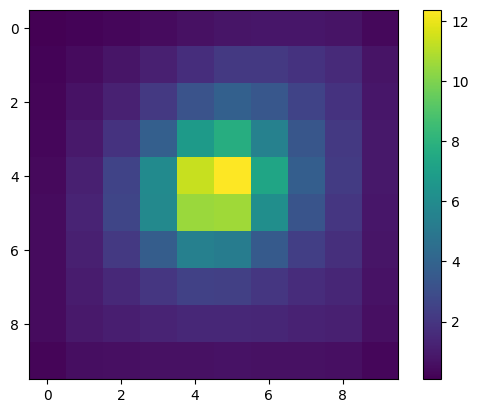

In [ ]:
m = plt.imshow(np.mean(inputs_[:,:,:,0],axis=0))
plt.colorbar(m)

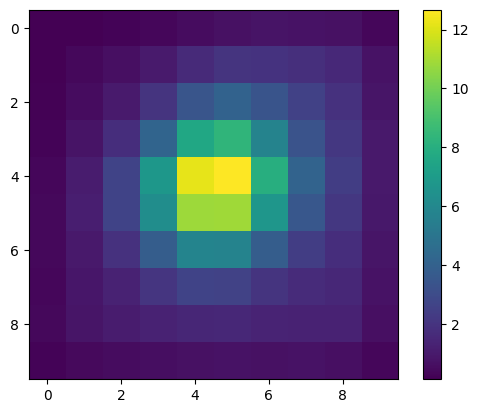

In [ ]:
m = plt.imshow(np.mean(inputs_pred[:,:,:,0],axis=0))
plt.colorbar(m)

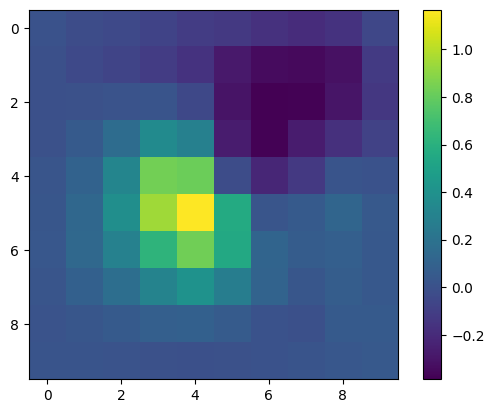

In [ ]:
ploooot = np.mean(inputs_pred[:,:,:,0],axis=0) - np.mean(inputs_pred_x[:,:,:,0],axis=0)
m = plt.imshow(ploooot)
plt.colorbar(m)

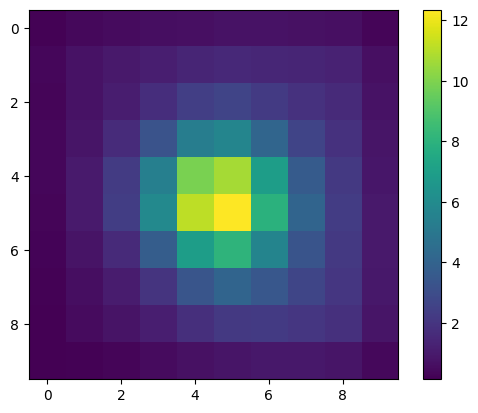

In [ ]:
m = plt.imshow(np.mean(inputs_x_[:,:,:,0],axis=0))
plt.colorbar(m)

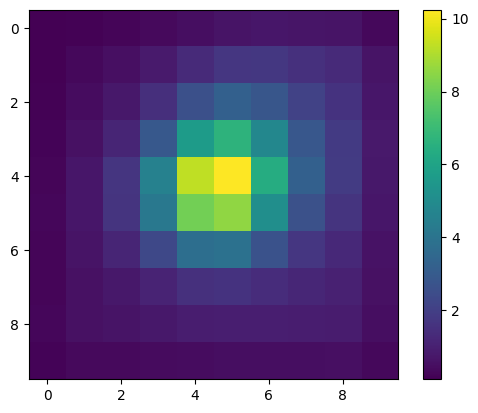

In [ ]:
m = plt.imshow(np.mean(inputs_pred_all[:,:,:,0],axis=0))
plt.colorbar(m)

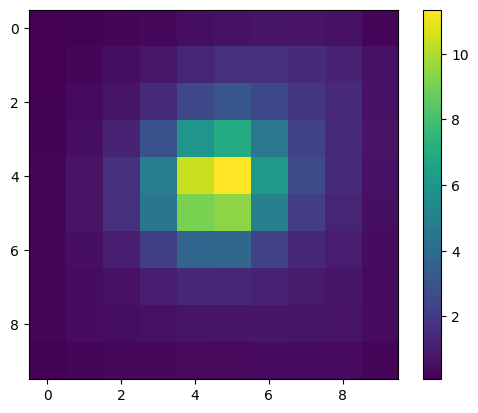

In [ ]:
m = plt.imshow(np.mean(inputs_pred_x_all[:,:,:,0],axis=0))
plt.colorbar(m)

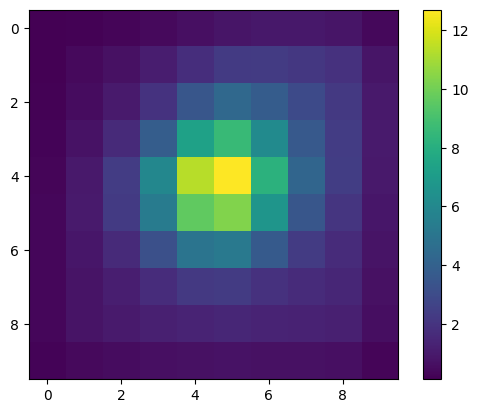

In [ ]:
m = plt.imshow(np.mean(inputs_pred_x[:,:,:,0],axis=0))
plt.colorbar(m)

In [ ]:
inputs_3 = np.load('/user/work/al18709/tc_data_flipped/test_combined_X.npy')
inputs_3_extreme_valid = np.load('/user/work/al18709/tc_data_flipped/extreme_valid_combined_X.npy')
inputs_3_x = np.load('/user/work/al18709/tc_data_flipped/extreme_test_combined_X.npy')
print(inputs_3.shape)

(15705, 10, 10, 7)


In [ ]:
print(inputs_3_extreme_valid.shape)
print(inputs_3_x.shape)

(5343, 100, 100, 7)
(5217, 10, 10, 7)


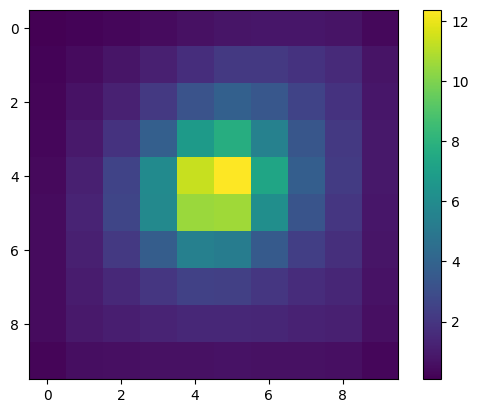

In [ ]:
m = plt.imshow(np.mean(inputs_3[:,:,:,0],axis=0))
plt.colorbar(m)

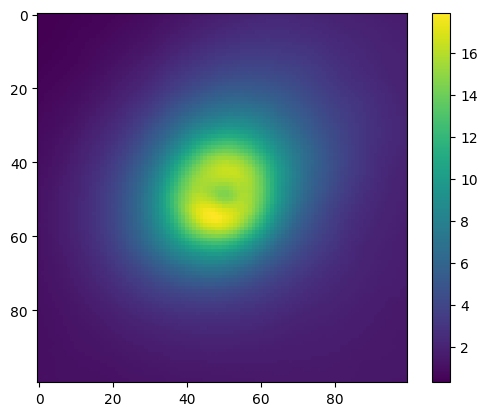

In [ ]:
m = plt.imshow(np.mean(inputs_3_extreme_valid[:,:,:,0],axis=0))
plt.colorbar(m)

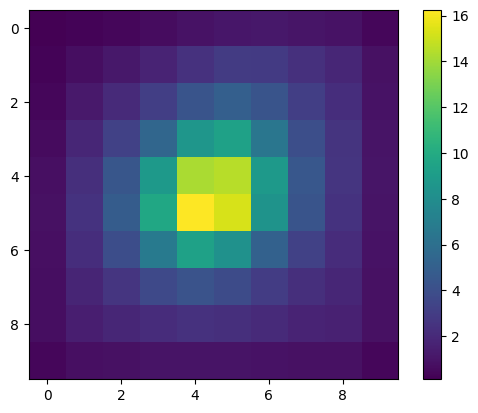

In [ ]:
m = plt.imshow(np.mean(inputs_3_x[:,:,:,0],axis=0))
plt.colorbar(m)

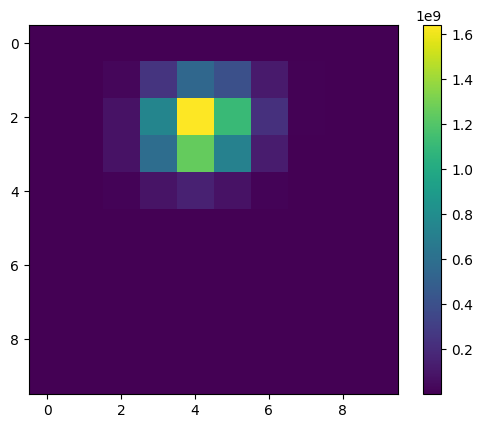

In [ ]:
m = plt.imshow(np.mean(inputs_pred_new[:,:,:,0],axis=0))
plt.colorbar(m)

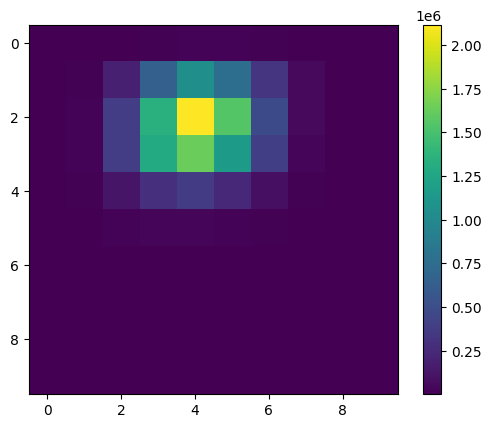

In [ ]:
m = plt.imshow(np.mean(inputs_pred_new_x[:,:,:,0],axis=0))
plt.colorbar(m)

In [ ]:
inputs_all = np.load('/user/work/al18709/tc_data_flipped/test_combined_X_all.npy')
inputs_all_x = np.load('/user/work/al18709/tc_data_flipped/extreme_test_combined_X_all.npy')


In [ ]:
print(inputs_all.shape)

(15705, 10, 10, 9)


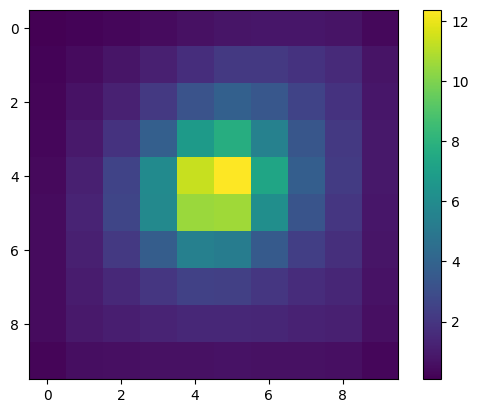

In [ ]:
m = plt.imshow(np.mean(inputs_all[:,:,:,0],axis=0))
plt.colorbar(m)

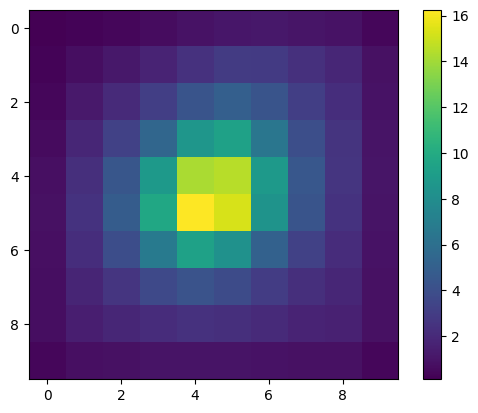

In [ ]:
m = plt.imshow(np.mean(inputs_all_x[:,:,:,0],axis=0))
plt.colorbar(m)

In [ ]:
print(np.sum(inputs_x_[0,:,:,0]-inputs_pred_x[0,:,:,0]))

6.048654195289771e-07


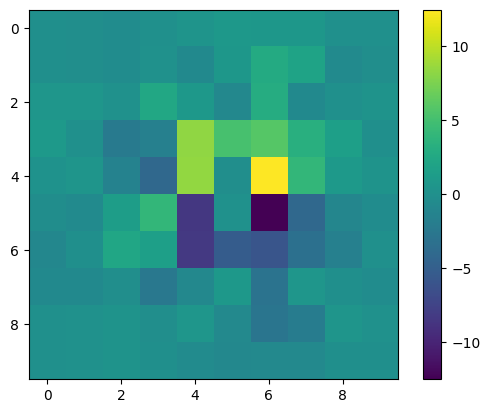

In [ ]:
m = plt.imshow(inputs_x_[100,:,:,0]-inputs_pred_x[100,:,:,0])
plt.colorbar(m)

In [ ]:
print(inputs_3.shape)

(15705, 10, 10, 7)


In [ ]:
print(np.mean(inputs_3[1:],axis=(0)).shape)

(10, 10, 7)


In [ ]:

print(np.mean(inputs_3[1:],axis=(0,1,2)))
print(np.mean(inputs_3_x[1:],axis=(0,1,2)))

[ 2.21474244e+00  1.00706986e+05  1.49255680e-02 -5.34063881e-02
 -2.13129803e+00  8.57054502e-02  8.18628032e-01]
[ 3.13794388e+00  1.00407185e+05  1.55597880e-02 -1.43534768e+00
 -1.40150218e+00  3.45737100e-01  1.19643339e+00]


In [ ]:
print(np.mean(inputs_for_training,axis=(0)))
print(np.mean(inputs_for_training_x,axis=(0)))

[ 1.00706980e+05 -2.13124207e+00  8.18656330e-01  5.31549456e+00
  8.04072353e+00  4.23907330e+01]
[ 1.00407205e+05 -1.40140477e+00  1.19587893e+00  5.80235434e+00
  1.37420118e+01  9.35701093e+01]


In [ ]:
inputs_for_training_all = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/all_test_X.npy')
inputs_for_training_x_all = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/all_extreme_test_X.npy')

In [ ]:
print(np.mean(inputs_for_training_all,axis=(0)))
print(np.mean(inputs_for_training_x_all,axis=(0)))

[ 1.00014691e+05  2.06929972e+00 -6.53276885e+00  8.74769346e+00
  8.04072353e+00  4.23907330e+01  2.76879084e+02  8.25081345e+01]
[ 9.94765368e+04  2.09546184e+00 -1.29781243e+01  1.02253055e+01
  1.37420118e+01  9.35701093e+01  2.77538742e+02  8.69759805e+01]


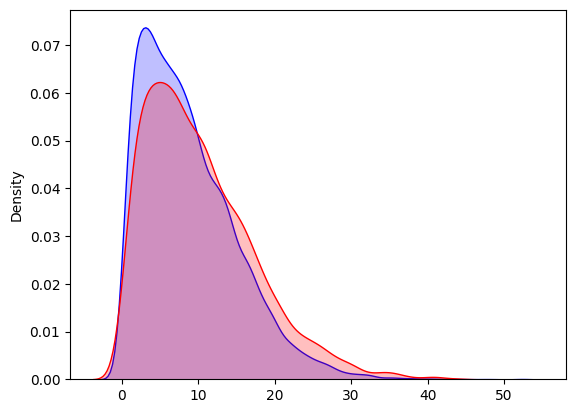

In [ ]:
sns.kdeplot(inputs_for_training_all[:,3], fill=True,color='blue')
sns.kdeplot(inputs_for_training_x_all[:,3], fill=True,color='red')
plt.show()

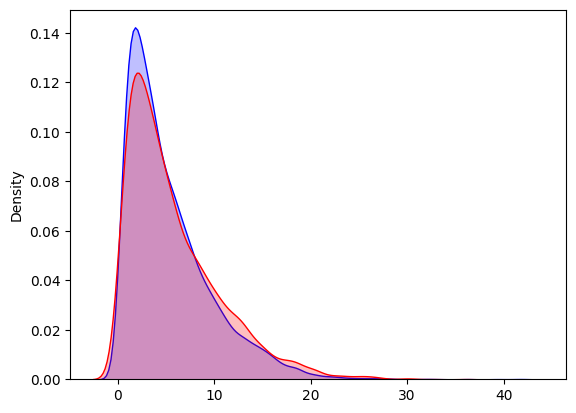

In [ ]:
sns.kdeplot(inputs_for_training[:,3], fill=True,color='blue')
sns.kdeplot(inputs_for_training_x[:,3], fill=True,color='red')
plt.show()

In [ ]:
dataset = 'extreme_valid'
x = np.float32(np.expand_dims(np.load('/user/work/al18709/tc_data_flipped/%s_combined_X.npy' % dataset)[:,:,:,0],axis=3))

In [ ]:
print(x.shape)

(5343, 100, 100, 1)


In [ ]:
inputs_for_training_2 = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/train_y_regrid.npy')
inputs_for_training_2_x = np.load('/user/work/al18709/tc_data_flipped/KE_tracks/extreme_valid_y_regrid.npy')

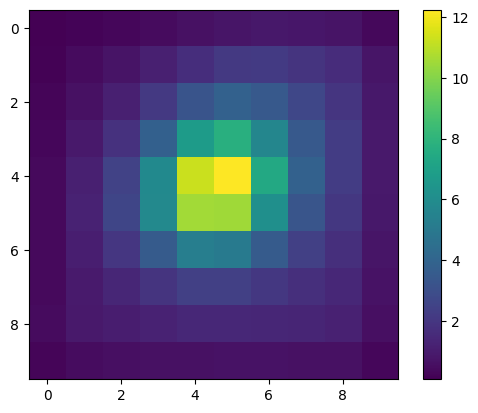

In [ ]:
m = plt.imshow(np.mean(inputs_for_training_2[:,:,:],axis=0))
plt.colorbar(m)

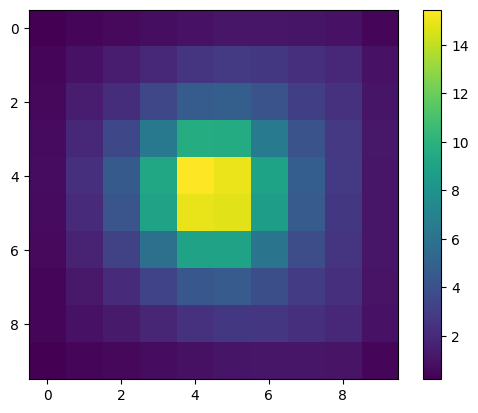

In [ ]:
m = plt.imshow(np.mean(inputs_for_training_2_x[:,:,:],axis=0))
plt.colorbar(m)